In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.path as mpath
import matplotlib.cm as cm
import matplotlib.patches as mpatches
from matplotlib.patches import Rectangle
from matplotlib.patches import Circle
#import seaborn as sns
import numpy as np
#import pandas as pd
#import scipy
import datetime
import cartopy
#from metpy.units import units
import cartopy.crs as ccrs
import gc



In [2]:
# Extract the rotated coordinate system from example file
ds=xr.open_dataset('clt_monthlyA_PXANT11_RACMO24p1v3_CESM_historical_198501_201412.nc')

crs_rot = ccrs.RotatedPole(pole_longitude=ds.rotated_pole.attrs['grid_north_pole_longitude'],\
                           pole_latitude=ds.rotated_pole.attrs['grid_north_pole_latitude'])

In [ ]:
#Define new Domain masks 
gridspacing = 0.75
lat = np.arange(-90, 90 + gridspacing, gridspacing)
lon = np.arange(-180, 180 + gridspacing, gridspacing)

ds_dummy = xr.Dataset(
    {"dummy": (("lat", "lon"), np.ones([len(lat), len(lon)]))},
    coords={"lon": lon, "lat": lat}
)

dd = ds_dummy.copy()

# --- Define regional masks using correct lon/lat ranges ---
mask_domain_EastAntarctic = dd.dummy.where(
    (dd.lat >= -80) & (dd.lat < -75) &
    (dd.lon >= 60) & (dd.lon <= 150)
).notnull()

mask_domain_WestAntarctic = dd.dummy.where(
    (dd.lat >= -80) & (dd.lat < -75) &
    (dd.lon >= -150) & (dd.lon <= -80)
).notnull()

mask_domain_Peninsula = dd.dummy.where(
    (dd.lat >= -75) & (dd.lat < -65) &
    (dd.lon >= -80) & (dd.lon <= -55)
).notnull()

# Ross Sea crosses the 180° line (150W = -150, 160E = 160)
mask_domain_Ross = dd.dummy.where(
    (dd.lat >= -85) & (dd.lat < -75) &
    ((dd.lon >= 150) | (dd.lon <= -150))
).notnull()

mask_domain_Weddel = dd.dummy.where(
    (dd.lat >= -85) & (dd.lat < -75) &
    (dd.lon >= -80) & (dd.lon <= -30)
).notnull()

# --- Collect all masks into a dictionary ---
mask_domains = {
    "EastAntarctic": {
        "mask": mask_domain_EastAntarctic,
        "color": "darkred",
        "north": -75,
        "south": -80,
        "east": 150,
        "west": 60
    },
    "WestAntarctic": {
        "mask": mask_domain_WestAntarctic,
        "color": "darkblue",
        "north": -75,
        "south": -80,
        "east": -80,
        "west": -150
    },
    "Peninsula": {
        "mask": mask_domain_Peninsula,
        "color": "gold",
        "north": -65,
        "south": -75,
        "east": -55,
        "west": -80
    },
    "Ross": {
        "mask": mask_domain_Ross,
        "color": "green",
        "north": -75,
        "south": -85,
        "east": 160,
        "west": -150
    },
    "Weddel": {
        "mask": mask_domain_Weddel,
        "color": "firebrick",
        "north": -75,
        "south": -85,
        "east": -30,
        "west": -80
    }
}

# === Collect in dictionary ===
mask_domains = {
    "EastAntarctic": {"mask": mask_domain_EastAntarctic, "color": "darkred"},
#    "WestAntarctic": {"mask": mask_domain_WestAntarctic, "color": "darkblue"},
    "Peninsula": {"mask": mask_domain_Peninsula, "color": "gold"},
    "Ross": {"mask": mask_domain_Ross, "color": "green"},
    "Weddel": {"mask": mask_domain_Weddel, "color": "darkblue"},
}

In [ ]:
model_data = {'HCLIM-ERA5': {'clt':ds_HCLIM_ERA5_ant_clt.clt,'clivi':ds_HCLIM_ERA5_ant_clivi.clivi,'clwvi':ds_HCLIM_ERA5_ant_clwvi,'varclt':'clt','varclivi':'clivi','varclwvi':'clqvi'},
              'HCLIM-CESM':{'clt':ds_HCLIM_CESM_ant_clt.clt,'clivi':ds_HCLIM_CESM_ant_clivi.clivi,'clwvi':ds_HCLIM_CESM_ant_clwvi,'varclt':'clt','varclivi':'clivi','varclwvi':'clqvi'},
              'HCLIM-MPI':{'clt':ds_HCLIM_MPI_ant_clt.clt,'clivi':ds_HCLIM_MPI_ant_clivi.clivi,'clwvi':ds_HCLIM_MPI_ant_clwvi,'varclt':'clt','varclivi':'clivi','varclwvi':'clqvi'},
              'RACMO-ERA5':{'clt':racmo_ERA5_clt,'clivi':racmo_ERA5_clivi,'clwvi':racmo_ERA5_clwvi,'varclt':'clt','varclivi':'clivi','varclwvi':'clwvi'},
              'RACMO-CESM':{'clt':racmo_ant_clt,'clivi':racmo_ant_clivi,'clwvi':racmo_ant_clwvi,'varclt':'clt','varclivi':'clivi','varclwvi':'clwvi'},
              'RACMO-MPI':{'clt':racmo_mpi_clt,'clivi':racmo_mpi_clivi,'clwvi':racmo_mpi_clwvi,'varclt':'clt','varclivi':'clivi','varclwvi':'clwvi'}}

### Function

In [3]:
def subplot_polarday(ds,var,vmin,vmax,title):
    fig, axs = plt.subplots(2,3,figsize=(18,9),subplot_kw={'projection':ccrs.Orthographic(0,-90)})
    axs = axs.flatten()

    months = [0, 1, 2,9, 10, 11]
    month_names = ['Jan', 'Feb', 'Mar','Oct','Nov','Dec']

     # Plot each month
    for i, (m, name) in enumerate(zip(months, month_names)):
        da = ds[m,:,:]
        da.plot(ax=axs[i],
                 transform=crs_rot,         # source CRS (change to PlateCarree() if lat/lon grid)
                 cmap='Blues',
                 add_colorbar=True,
                 vmin=vmin, vmax=vmax)

        axs[i].set_title(name, fontsize=14)
        axs[i].set_extent([-180, 180, -90, -60], crs=ccrs.PlateCarree())
        axs[i].gridlines(linestyle='--', zorder=3)
        axs[i].coastlines(zorder=2)
        axs[i].add_feature(cartopy.feature.LAND, color='lightgray',zorder=0, edgecolor='None')

    fig.suptitle(title,fontsize=14)

    plt.show()

In [4]:
def subplot_model_bias(ds_model,ds_obs,var_model,var_obs,vmin,vmax,title):
    fig, axs = plt.subplots(2,3,figsize=(18,9),subplot_kw={'projection':ccrs.Orthographic(0,-90)})
    axs = axs.flatten()

    months = [0, 1, 2,9, 10, 11]
    month_names = ['Jan', 'Feb', 'Mar','Oct','Nov','Dec']

    # Plot each month
    for i, (m, name) in enumerate(zip(months, month_names)):

        model = ds_model[m,:,:]
        obs = ds_obs[m,:,:]
        diff = model - obs
        diff.plot(ax=axs[i],
                transform=crs_rot,         # source CRS (change to PlateCarree() if lat/lon grid)
                cmap='RdBu_r',
                add_colorbar=True,vmin=vmin, vmax=vmax)

        axs[i].set_title(name, fontsize=14)
        axs[i].set_extent([-180, 180, -65, -90], crs=ccrs.PlateCarree())
        axs[i].gridlines(linestyle='--', zorder=3)
        axs[i].coastlines(zorder=2)
        axs[i].add_feature(cartopy.feature.LAND, color='lightgray', zorder=0, edgecolor='None')

    fig.suptitle(title,fontsize=14)

    plt.show()

### Cloud_CCI

In [38]:
ds_cliviCCI_remapped = xr.open_dataset('SARAH/remapbil_R_clivi_mon_ESACCI-CLOUD-AVHRR-AM-3-0_BE_gr_2001-2016.nc')

In [39]:
ds_cliviCCI_remapped = ds_cliviCCI_remapped.groupby(ds_cliviCCI_remapped.time.dt.month).mean(dim='time') ## important for the monthly data

In [40]:
ds_clwviCCI_remapped = xr.open_dataset('SARAH/remapbil_R_clwvi_mon_ESACCI-CLOUD-AVHRR-AM-3-0_BE_gr_2001-2016.nc')

In [41]:
ds_clwviCCI_remapped = ds_clwviCCI_remapped.groupby(ds_clwviCCI_remapped.time.dt.month).mean(dim='time') ## important for the monthly data

In [6]:
ds_cltCCI_remapped = xr.open_dataset('SARAH/remapbil_R_cltCCI_mon_ESACCI-CLOUD-AVHRR-AM-3-0_BE_gr_2001-2016.nc')

In [7]:
ds_cltCCI_remapped = ds_cltCCI_remapped.groupby(ds_cltCCI_remapped.time.dt.month).mean(dim='time') ## important for the monthly data

In [410]:
ds_cltCCI_remapped_every_m = xr.open_dataset('SARAH/remapbil_R_cltCCI_mon_ESACCI-CLOUD-AVHRR-AM-3-0_BE_gr_2001-2016.nc')

### CLARA

In [8]:
clara_ant_clt=xr.open_dataset('CLARA/remapbil_R_CFCmm_cfc_2001-2016_9AVPOS01GL.nc')

In [9]:
clara_ant_clt = clara_ant_clt.groupby(clara_ant_clt.time.dt.month).mean(dim='time') ## important for the monthly data

In [10]:
clara_ant_clt_every_m=xr.open_dataset('CLARA/remapbil_R_CFCmm_cfc_2001-2016_9AVPOS01GL.nc')

### RACMO-CESM

In [15]:
racmo_ant=xr.open_dataset('clt_monthlyA_PXANT11_RACMO24p1v3_CESM_historical_198501_201412.nc')

In [16]:
racmo_ant_clt = racmo_ant.clt.sel(time=slice("2001-01-01","2016-12-31"))
#racmo_ant_clt

In [17]:
racmo_ant_clt = racmo_ant_clt.groupby(racmo_ant_clt.time.dt.month).mean(dim='time') ## important for the monthly data

In [193]:
racmo_ant_clt = racmo_ant_clt*100

In [231]:
racmo_ant_clwvi=xr.open_dataset('RACMO/clwvi_monthlyA_PXANT11_RACMO24p1v3_CESM_historical_198501_201412.nc')

In [232]:
racmo_ant_clwvi = racmo_ant_clwvi.clwvi.sel(time=slice("2001-01-01","2016-12-31"))
racmo_ant_clwvi = racmo_ant_clwvi.groupby(racmo_ant_clwvi.time.dt.month).mean(dim='time') ## important for the monthly data
racmo_ant_clwvi = racmo_ant_clwvi.mean(dim='height')

In [228]:
racmo_ant_clivi=xr.open_dataset('RACMO/clivi_monthlyA_PXANT11_RACMO24p1v3_CESM_historical_198501_201412.nc')

In [229]:
racmo_ant_clivi = racmo_ant_clivi.clivi.sel(time=slice("2001-01-01","2016-12-31"))
racmo_ant_clivi = racmo_ant_clivi.groupby(racmo_ant_clivi.time.dt.month).mean(dim='time') ## important for the monthly data
racmo_ant_clivi = racmo_ant_clivi.mean(dim='height')

### RACMO- ERA5

In [25]:
racmo_ERA5_clt=xr.open_dataset('RACMO/clt_monthlyA_PXANT11_RACMO24p1v5_ERA5_2001_2016.nc')

In [26]:
racmo_ERA5_clt = racmo_ERA5_clt.clt.sel(time=slice("2001-01-01","2016-12-31"))
racmo_ERA5_clt = racmo_ERA5_clt.groupby(racmo_ERA5_clt.time.dt.month).mean(dim='time') ## important for the monthly data

In [89]:
racmo_ERA5_clt = racmo_ERA5_clt.mean(dim='height')*100

In [237]:
racmo_ERA5_clwvi=xr.open_dataset('RACMO/clwvi_monthlyA_PXANT11_RACMO24p1v5_ERA5_196001_202501.nc')

In [238]:
racmo_ERA5_clwvi = racmo_ERA5_clwvi.clwvi.sel(time=slice("2001-01-01","2016-12-31"))
racmo_ERA5_clwvi = racmo_ERA5_clwvi.groupby(racmo_ERA5_clwvi.time.dt.month).mean(dim='time') ## important for the monthly data
#racmo_ERA5_clwvi = racmo_ERA5_clwvi.clwvi(dim='height')

In [240]:
racmo_ERA5_clwvi = racmo_ERA5_clwvi.mean(dim='height')

In [241]:
racmo_ERA5_clivi=xr.open_dataset('RACMO/clivi_monthlyA_PXANT11_RACMO24p1v5_ERA5_196001_202501.nc')

In [242]:
racmo_ERA5_clivi = racmo_ERA5_clivi.clivi.sel(time=slice("2001-01-01","2016-12-31"))
racmo_ERA5_clivi = racmo_ERA5_clivi.groupby(racmo_ERA5_clivi.time.dt.month).mean(dim='time') ## important for the monthly data
racmo_ERA5_clivi = racmo_ERA5_clivi.mean(dim='height')

In [432]:
racmo_ERA5_clt_every_m=xr.open_dataset('C:/Users/kalma/Downloads/transfer_3330991_files_8404dbcd_uj/clt_monthlyA_PXANT11_RACMO24p1v5_ERA5_196001_202501.nc')
racmo_ERA5_clt_every_m = racmo_ERA5_clt_every_m.sel(time=slice("2001-01-01","2016-12-31"))

In [434]:
racmo_ERA5_clt_every_m = racmo_ERA5_clt_every_m.clt.mean(dim='height')*100

### RACMO - MPI 

In [118]:
racmo_mpi_ant=xr.open_dataset('RACMO/clt_monthlyA_PXANT11_RACMO24p1v3_MPI_historical_198501_201412.nc')

In [121]:
racmo_mpi_clt = racmo_mpi_ant.clt.sel(time=slice("2001-01-01","2016-12-31"))
#racmo_ant_clt
racmo_mpi_clt = racmo_mpi_clt.groupby(racmo_mpi_clt.time.dt.month).mean(dim='time') ## important for the monthly data
racmo_mpi_clt = racmo_mpi_clt.mean(dim='height')*100

In [220]:
racmo_mpi_ant=xr.open_dataset('RACMO/clivi_monthlyA_PXANT11_RACMO24p1v3_MPI_historical_198501_201412.nc')

In [221]:
racmo_mpi_clivi = racmo_mpi_ant.clivi.sel(time=slice("2001-01-01","2016-12-31"))
#racmo_ant_clt
racmo_mpi_clivi = racmo_mpi_clivi.groupby(racmo_mpi_clivi.time.dt.month).mean(dim='time') ## important for the monthly data
racmo_mpi_clivi = racmo_mpi_clivi.mean(dim='height')

In [127]:
racmo_mpi_ant=xr.open_dataset('RACMO/clwvi_monthlyA_PXANT11_RACMO24p1v3_MPI_historical_198501_201412.nc')

In [128]:
racmo_mpi_clwvi = racmo_mpi_ant.clwvi.sel(time=slice("2001-01-01","2016-12-31"))
#racmo_ant_clt
racmo_mpi_clwvi = racmo_mpi_clwvi.groupby(racmo_mpi_clwvi.time.dt.month).mean(dim='time') ## important for the monthly data
racmo_mpi_clwvi = racmo_mpi_clwvi.mean(dim='height')

### HCLIM-ERA5 Data

In [335]:
ds_HCLIM_ERA5_clt_every_m = xr.open_mfdataset('HCLIM/remapbil_R_clt_ERA5_good.nc')


In [110]:
ds_HCLIM_ERA5_clt_mon = xr.open_mfdataset('HCLIM/remapbil_R_clt_ERA5_good.nc')
ds_HCLIM_ERA5_ant_clt = ds_HCLIM_ERA5_clt_mon.groupby(ds_HCLIM_ERA5_clt_mon.time.dt.month).mean(dim='time')

In [205]:
ds_HCLIM_ERA5_clivi_mon = xr.open_mfdataset('HCLIM/remapbil_R_clivi_ERA5_good.nc')
ds_HCLIM_ERA5_ant_clivi = ds_HCLIM_ERA5_clivi_mon.groupby(ds_HCLIM_ERA5_clivi_mon.time.dt.month).mean(dim='time')

In [203]:
ds_HCLIM_ERA5_clwvi_mon = xr.open_mfdataset('HCLIM/remapbil_R_clqvi_ERA5_good.nc')
ds_HCLIM_ERA5_ant_clwvi = ds_HCLIM_ERA5_clwvi_mon.groupby(ds_HCLIM_ERA5_clwvi_mon.time.dt.month).mean(dim='time')

### HCLIM-MPI Data

In [78]:
ds_HCLIM_MPI_clt_mon = xr.open_mfdataset('HCLIM/remapbil_R_clt_MPI.nc')
ds_HCLIM_MPI_ant_clt = ds_HCLIM_MPI_clt_mon.groupby(ds_HCLIM_MPI_clt_mon.time.dt.month).mean(dim='time')

In [79]:
ds_HCLIM_MPI_clivi_mon = xr.open_mfdataset('HCLIM/remapbil_R_clivi_MPI.nc')
ds_HCLIM_MPI_ant_clivi = ds_HCLIM_MPI_clivi_mon.groupby(ds_HCLIM_MPI_clivi_mon.time.dt.month).mean(dim='time')

In [275]:
ds_HCLIM_MPI_clwvi_mon = xr.open_mfdataset('HCLIM/remapbil_R_clqvi_MPI.nc')
#ds_HCLIM_MPI_ant_clwvi = ds_HCLIM_MPI_clwvi_mon.groupby(ds_HCLIM_MPI_clwvi_mon.time.dt.month).mean(dim='time')

### HCLIM-CESM Data

In [81]:
ds_HCLIM_CESM_clt_mon = xr.open_mfdataset('HCLIM/remapbil_R_clt_CESM.nc')
ds_HCLIM_CESM_ant_clt = ds_HCLIM_CESM_clt_mon.groupby(ds_HCLIM_CESM_clt_mon.time.dt.month).mean(dim='time')

In [82]:
ds_HCLIM_CESM_clivi_mon = xr.open_mfdataset('HCLIM/remapbil_R_clivi_CESM.nc')
ds_HCLIM_CESM_ant_clivi = ds_HCLIM_CESM_clivi_mon.groupby(ds_HCLIM_CESM_clivi_mon.time.dt.month).mean(dim='time')

In [256]:
ds_HCLIM_CESM_clwvi_mon = xr.open_mfdataset('HCLIM/remapbil_R_clqvi_CESM.nc')
ds_HCLIM_CESM_ant_clwvi = ds_HCLIM_CESM_clwvi_mon.groupby(ds_HCLIM_CESM_clwvi_mon.time.dt.month).mean(dim='time')

### Plot

#### Absolute Values

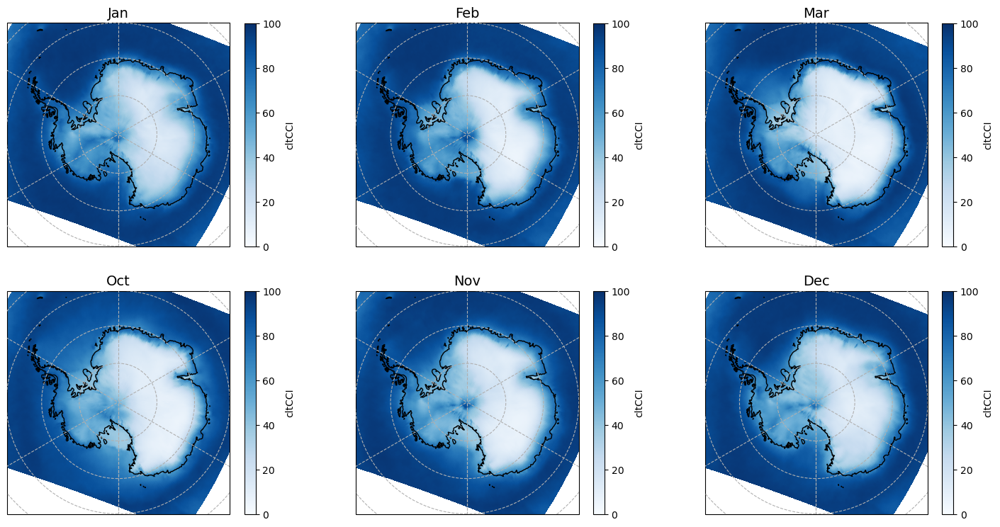

In [54]:
subplot_polarday(ds_cltCCI_remapped.cltCCI,'cltCCI',0,100,"") #it works 

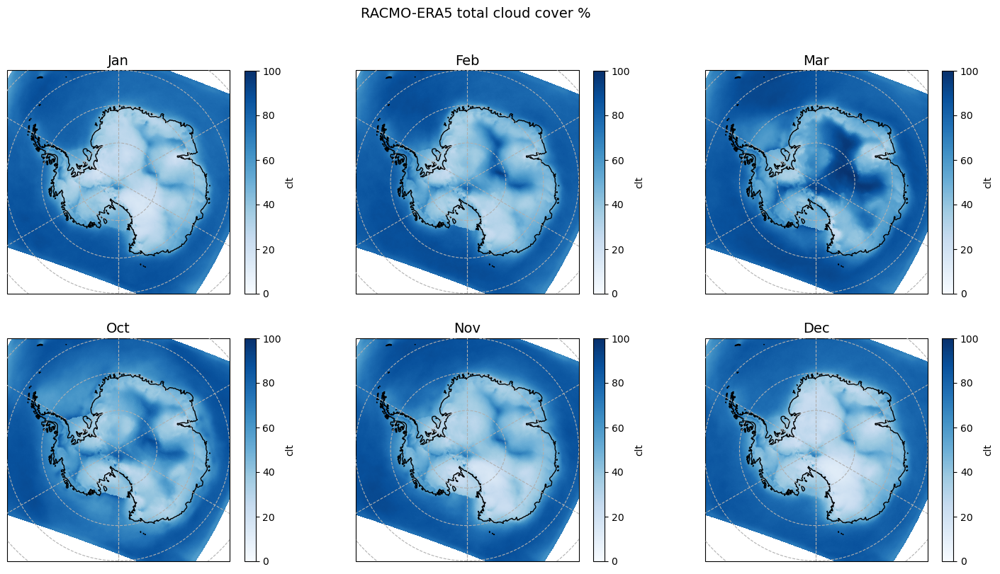

In [103]:
subplot_polarday(racmo_ERA5_clt,'clt',0,100,"RACMO-ERA5 total cloud cover %") #it works 

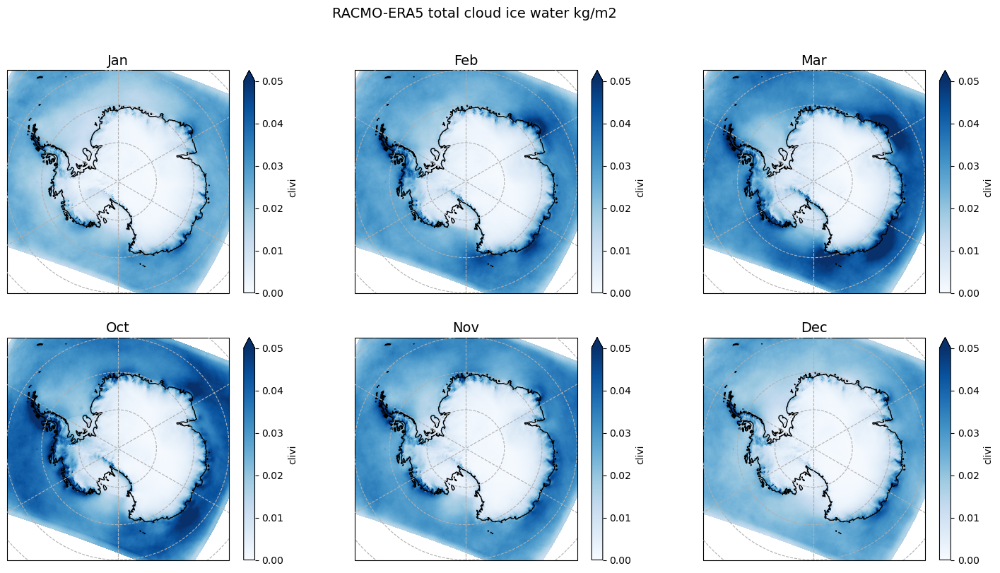

In [102]:
subplot_polarday(racmo_ERA5_clivi,'clivi',0,0.05,"RACMO-ERA5 total cloud ice water kg/m2") #it works 

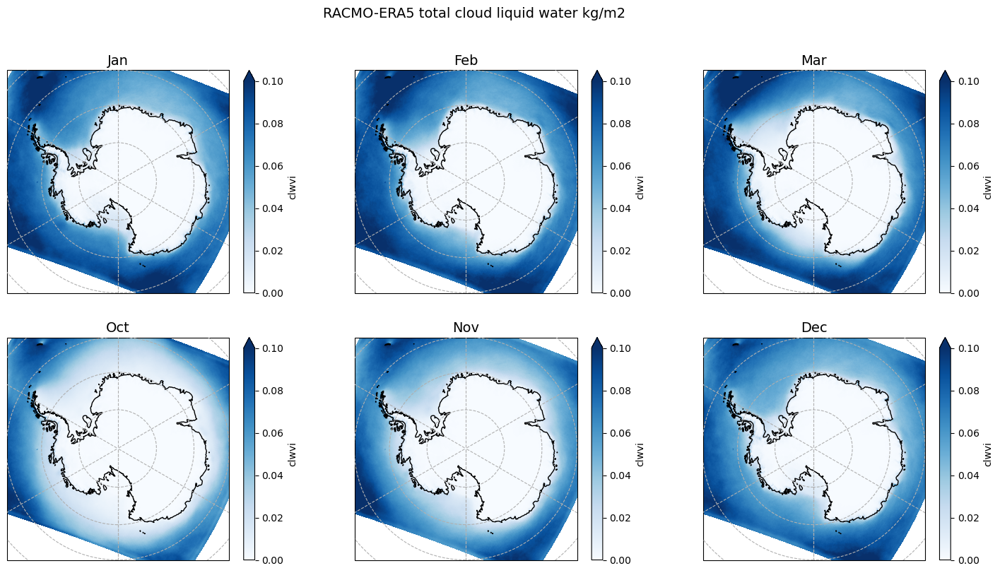

In [105]:
subplot_polarday(racmo_ERA5_clwvi,'clwvi',0,0.1,"RACMO-ERA5 total cloud liquid water kg/m2") #it works 

#### BIAS

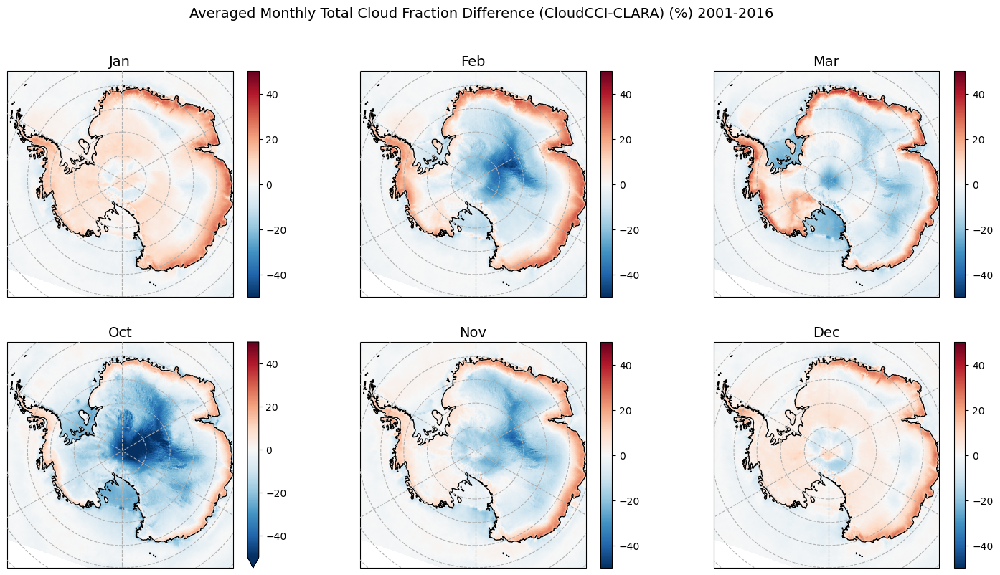

In [12]:
subplot_model_bias(ds_cltCCI_remapped.cltCCI,clara_ant_clt.cfc,'cltCCI','cfc',-50,50,'Averaged Monthly Total Cloud Fraction Difference (CloudCCI-CLARA) (%) 2001-2016')

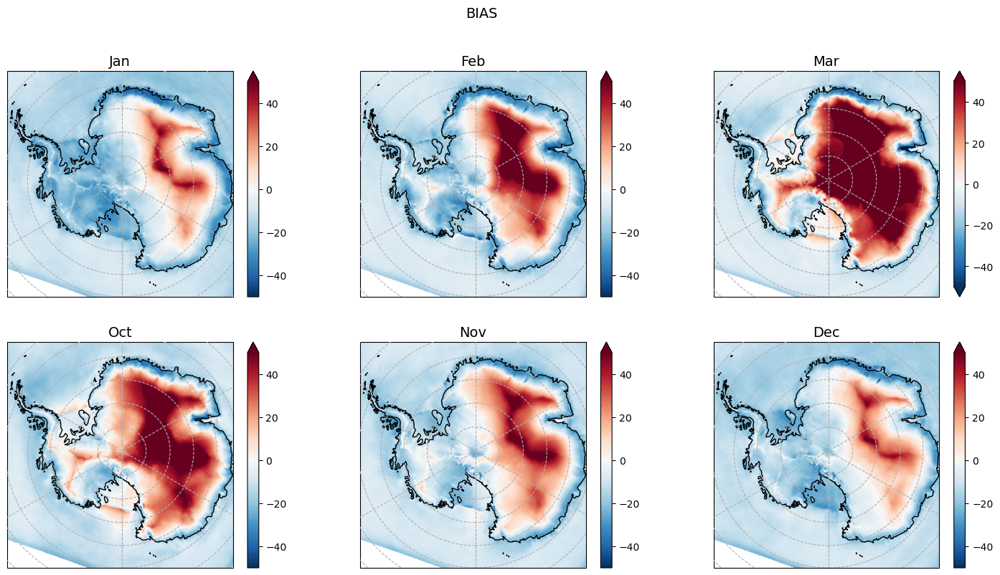

In [109]:
subplot_model_bias(racmo_ERA5_clt,ds_cltCCI_remapped.cltCCI,'clt','cltCCI',-50,50,'BIAS')

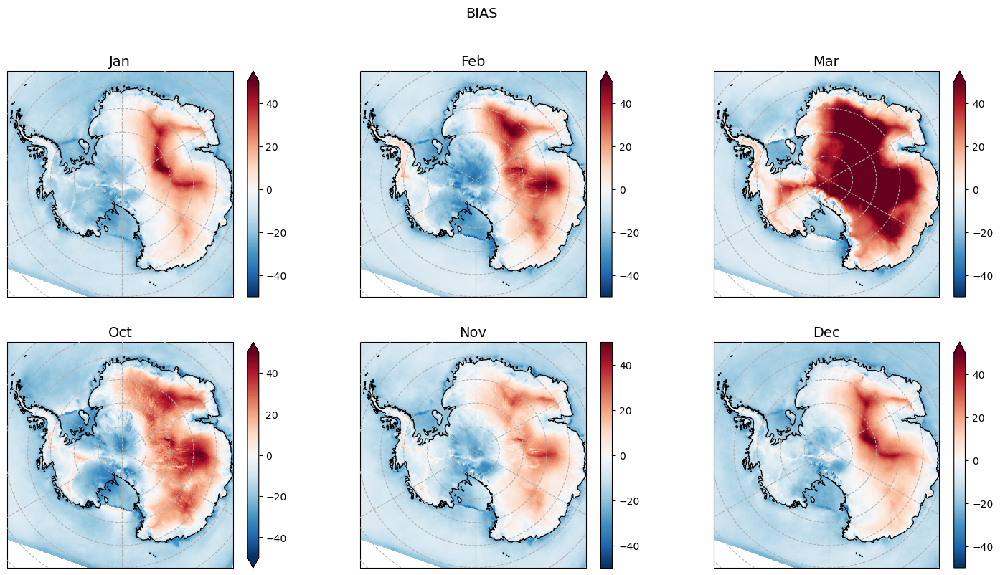

In [133]:
subplot_model_bias(racmo_ERA5_clt,clara_ant_clt.cfc,'clt','cfc',-50,50,'BIAS')

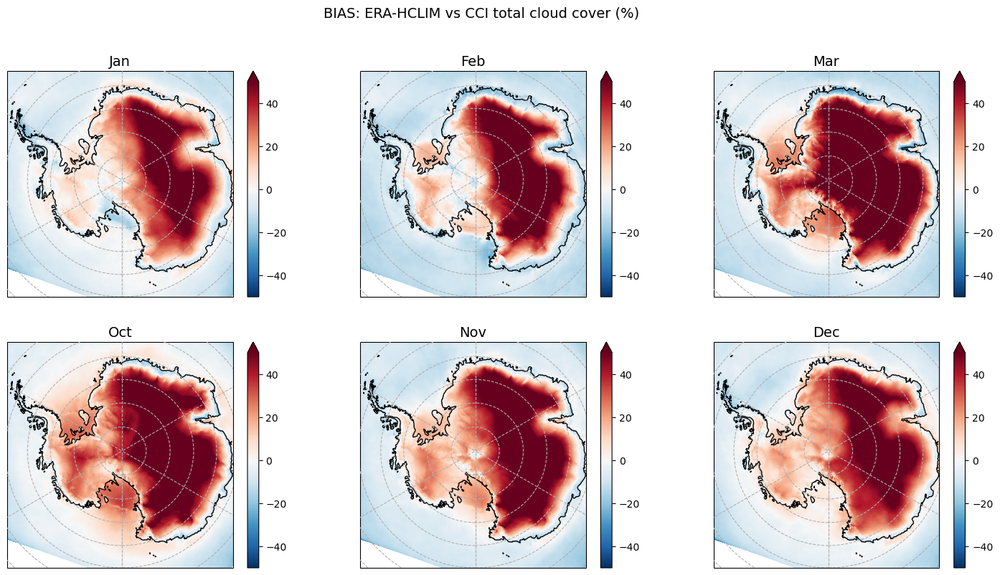

In [135]:
subplot_model_bias(ds_HCLIM_ERA5_ant_clt.clt,ds_cltCCI_remapped.cltCCI,'clt','cltCCI',-50,50,'BIAS: ERA-HCLIM vs CCI total cloud cover (%)')

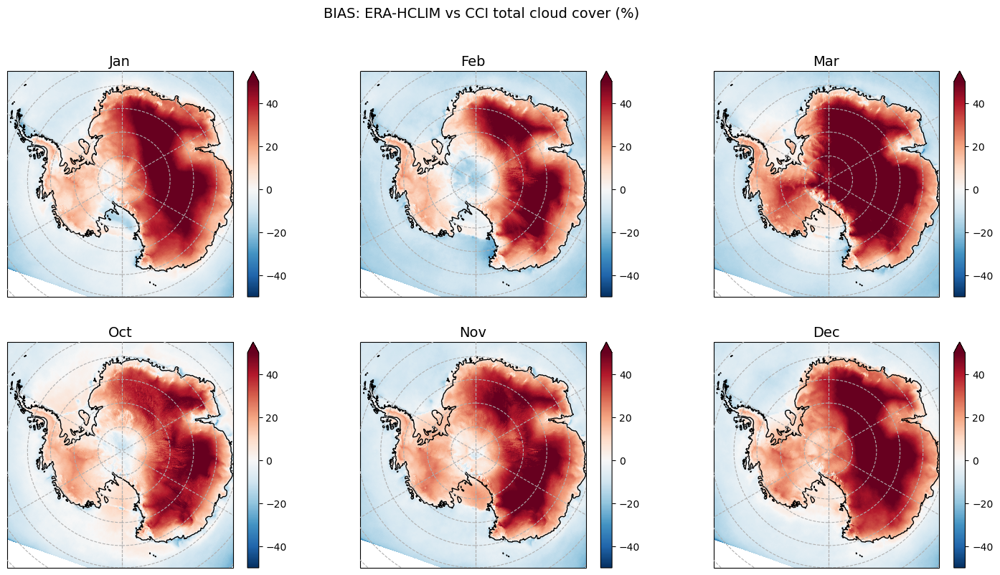

In [136]:
subplot_model_bias(ds_HCLIM_ERA5_ant_clt.clt,clara_ant_clt.cfc,'clt','cfc',-50,50,'BIAS: ERA-HCLIM vs CCI total cloud cover (%)')

### Subplot Overview

In [165]:
def super_subplot_model_bias(var_model,ds_obs, var_obs, vmin, vmax, title,unit):
    import matplotlib.pyplot as plt
    import cartopy.crs as ccrs
    import cartopy.feature as cfeature

    models = ['HCLIM-ERA5','HCLIM-CESM','HCLIM-MPI',
              'RACMO-ERA5','RACMO-CESM','RACMO-MPI']
    months = [9, 10, 11, 0, 1, 2]
    month_names = ['October', 'November', 'December','January','February','March']

    fig, axs = plt.subplots(
        len(models), len(months),
        figsize=(18, 18),
        subplot_kw={'projection': ccrs.Orthographic(0, -90)},
        constrained_layout=True
    )

    for i, modelname in enumerate(models):
        for j, (m, name) in enumerate(zip(months, month_names)):
            model = model_data[modelname][var_model][m,:,:]
            
            obs = ds_obs[var_obs][m,:,:]
            diff = model - obs

            h = diff.plot(
                ax=axs[i, j],
                transform=crs_rot,        # change if using PlateCarree
                cmap='RdBu_r',
                add_colorbar=False,
                vmin=vmin, vmax=vmax
            )

            axs[i, j].set_extent([-180, 180, -65, -90], crs=ccrs.PlateCarree())
            axs[i, j].gridlines(linestyle='--', zorder=3)
            axs[i, j].coastlines(zorder=2)
            axs[i, j].add_feature(cfeature.LAND, color='lightgray', zorder=0, edgecolor='None')

            # Add month titles only on top row
            if i == 0:
                axs[i, j].set_title(name, fontsize=16)
            else:
                axs[i, j].set_title("")  # no month titles below top row

            # Add model name on the leftmost column
            if j == 0:
                axs[i, j].text(
                    -0.2, 0.5, modelname,
                    va='center', ha='right',
                    rotation=90, fontsize=16,
                    transform=axs[i, j].transAxes
                )

    # Add one shared colorbar for all
    cbar = fig.colorbar(h, ax=axs, orientation='horizontal', fraction=0.025, pad=0.05)
    cbar.set_label(f'{var_model} bias (model − obs) ({unit})',fontsize=16)
    
    fig.suptitle(title, fontsize=17)

    plt.savefig('overview_models_cloudcci.png',dpi=200)
    plt.show()


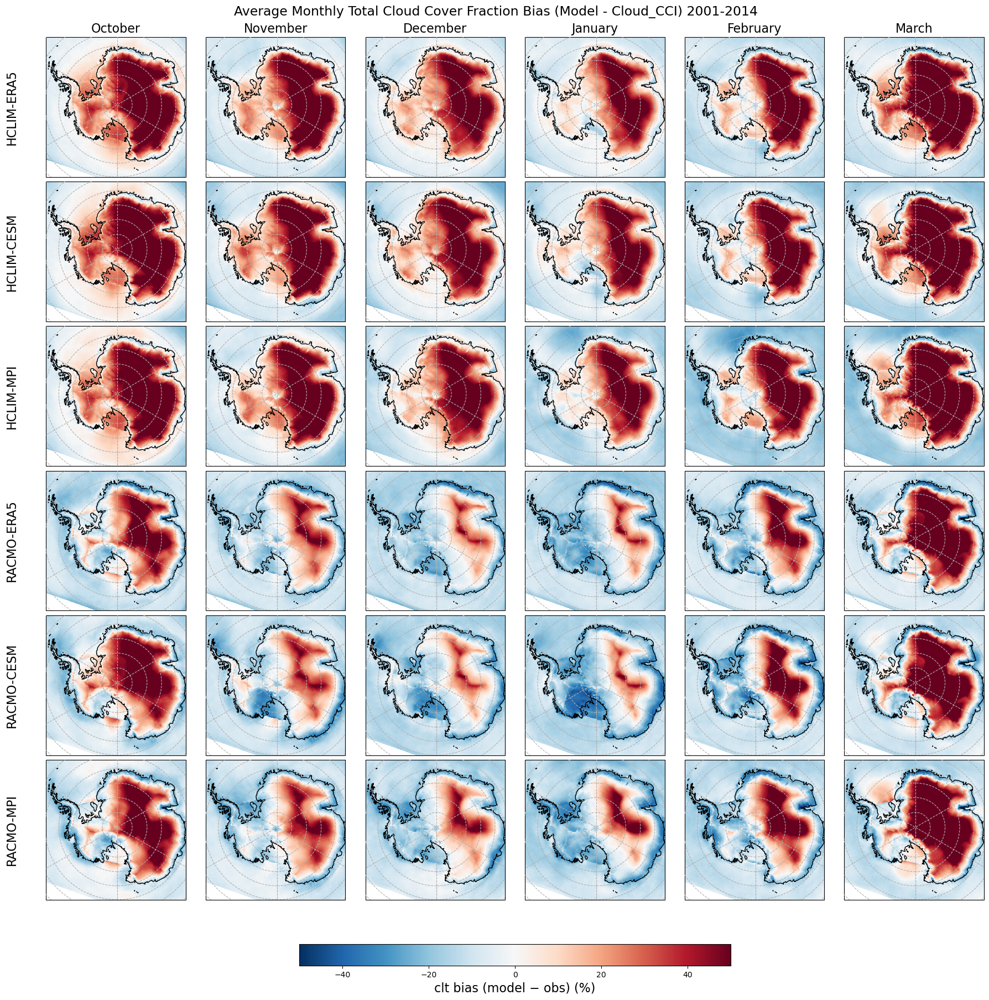

In [166]:
super_subplot_model_bias('clt', ds_cltCCI_remapped,'cltCCI',-50,50,'Average Monthly Total Cloud Cover Fraction Bias (Model - Cloud_CCI) 2001-2014','%')

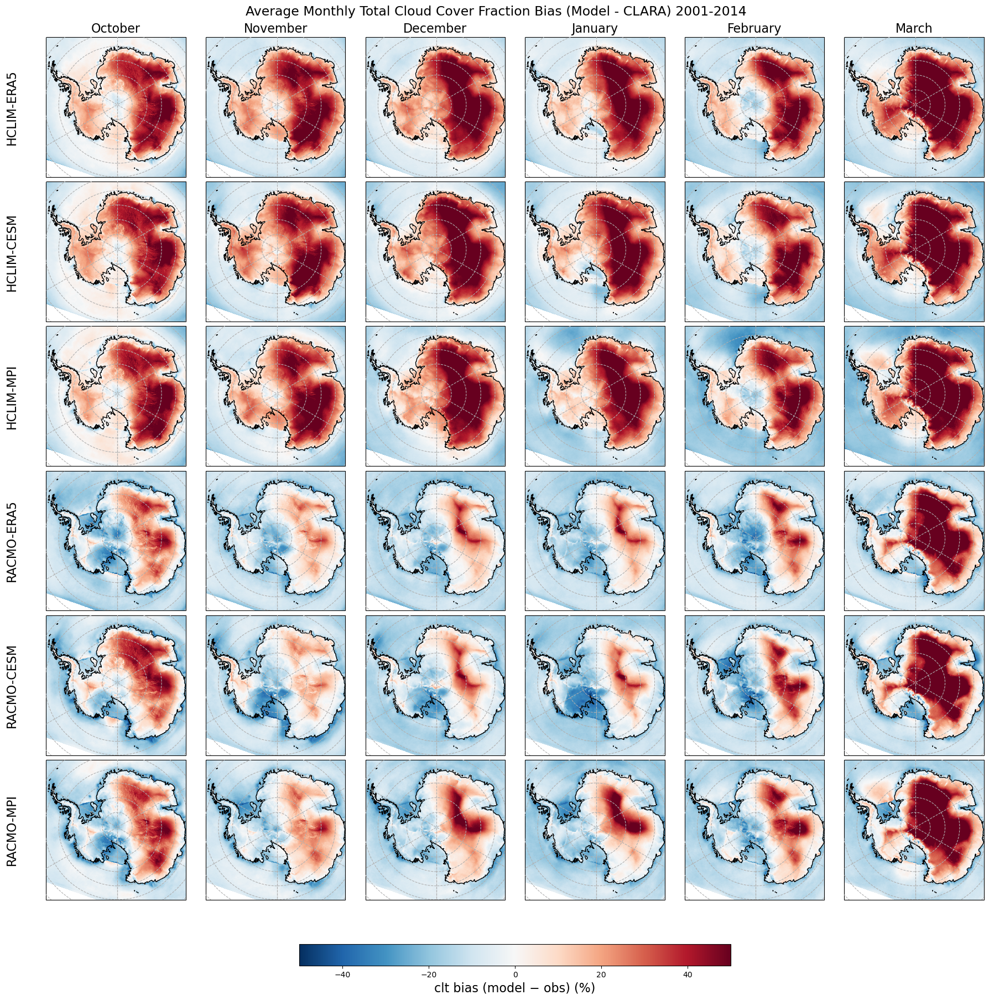

In [167]:
super_subplot_model_bias('clt',clara_ant_clt,'cfc',-50,50,'Average Monthly Total Cloud Cover Fraction Bias (Model - CLARA) 2001-2014','%')

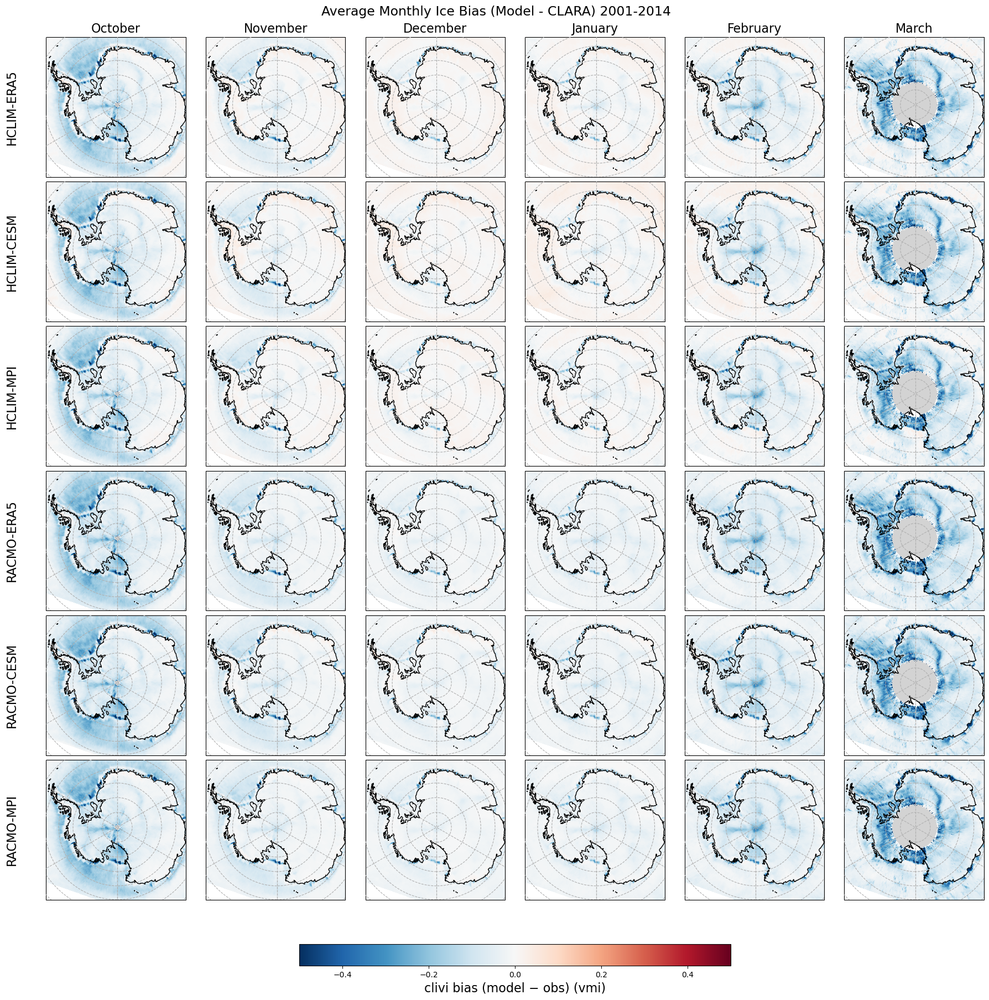

In [247]:
super_subplot_model_bias('clivi',ds_cliviCCI_remapped,'clivi',-0.5,0.5,'Average Monthly Ice Bias (Model - CLARA) 2001-2014','vmi')

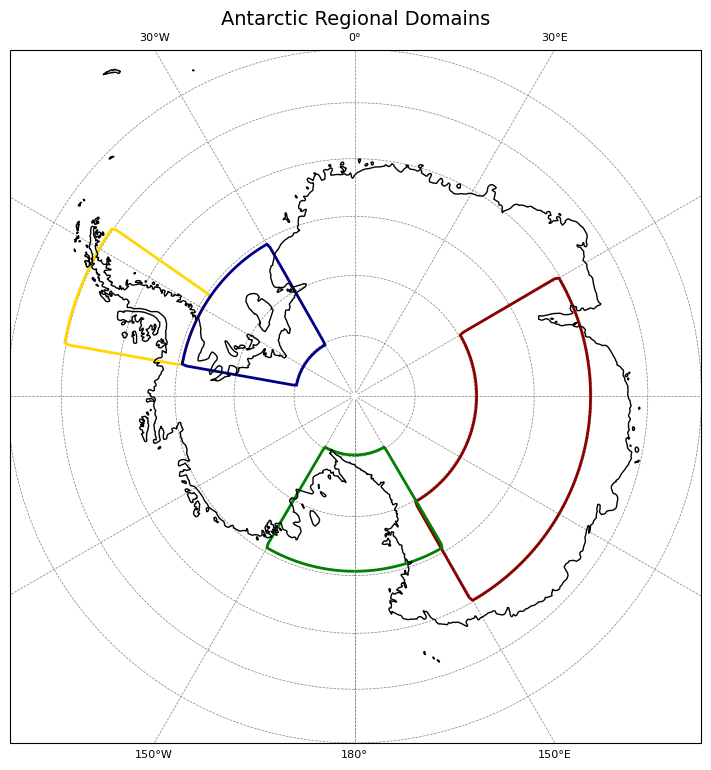

In [4]:

# === Plot on South Polar map ===
fig, ax = plt.subplots(
    1, 1,
    subplot_kw={'projection': ccrs.Orthographic(0, -90)},
    figsize=(9, 9)
)

# === Set clean white background ===
ax.set_facecolor("white")          # the visible map area
fig.patch.set_facecolor("white")   # the area outside the map

# Plot each domain mask
for domain_name, domain_data in mask_domains.items():
    mask = domain_data["mask"]
    if mask.max() > 0:
        mask.plot.contourf(
            levels=[0, 1],
            colors=[domain_data["color"]],
            alpha=0,
            zorder=3,
            ax=ax,
            transform=ccrs.PlateCarree(),
            add_colorbar=False
        )
        mask.plot.contour(
            levels=[0.5],
            colors=domain_data["color"],
            linewidths=2,
            zorder=4,
            ax=ax,
            transform=ccrs.PlateCarree(),
            add_colorbar=False
        )

# Add map features
ax.set_extent([-180, 180, -90, -60], crs=ccrs.PlateCarree())
ax.coastlines(zorder=5)
gl = ax.gridlines(
    draw_labels=True,
    linestyle='--',
    linewidth=0.5,
    color='gray',
    xlocs=np.arange(-180, 181, 30),
    ylocs=np.arange(-90, -59, 5),
    zorder=2
)
gl.xlabel_style = {'size': 8}
gl.ylabel_style = {'size': 8}

plt.title("Antarctic Regional Domains", fontsize=14)
plt.savefig("antarctic_domains.png", dpi=300, bbox_inches="tight")
plt.show()


### Timeseries

In [449]:
#Other section:
# function to filter
def get_filtered_domain(data,domain):
    filtered_domain = data.where(
         (data.lat >= mask_domains[domain]["south"]) &
         (data.lat <= mask_domains[domain]["north"]) &
         (data.lon >= mask_domains[domain]["west"]) &
         (data.lon <= mask_domains[domain]["east"])
     )
    filtered_domain = filtered_domain.sel(time=filtered_domain.time.dt.month.isin([9, 10, 11, 0, 1, 2]))

    filtered_domain_yearly = filtered_domain.groupby('time.year').mean('time') 

    return filtered_domain_yearly

In [450]:
## Define Areas - I need 192 timesteps 
def filter_areas(ds_data):
    EastAntarctic = get_filtered_domain(ds_data,'EastAntarctic')
    WestAntarctic = get_filtered_domain(ds_data,'WestAntarctic')
    Peninsula = get_filtered_domain(ds_data,'Peninsula')
    Ross = get_filtered_domain(ds_data,'Ross')
    Weddel = get_filtered_domain(ds_data,'Weddel')
    
    return EastAntarctic, WestAntarctic, Peninsula, Ross, Weddel



In [451]:
EastAntarctic_CloudCCI,WestAntarctic_CloudCCI,Peninsula_CloudCCI,Ross_CloudCCI,Weddel_CloudCCI = filter_areas(ds_cltCCI_remapped_every_m)

In [452]:
EastAntarctic_HCLIM_ERA5,WestAntarctic_HCLIM_ERA5,Peninsula_HCLIM_ERA5,Ross_HCLIM_ERA5,Weddel_HCLIM_ERA5 = filter_areas(ds_HCLIM_ERA5_clt_every_m)

In [454]:
EastAntarctic_RACMO_ERA5,WestAntarctic_RACMO_ERA5,Peninsula_RACMO_ERA5,Ross_RACMO_ERA5,Weddel_RACMO_ERA5 = filter_areas(racmo_ERA5_clt_every_m)

In [461]:
EastAntarctic_CLARA,WestAntarctic_CLARA,Peninsula_CLARA,Ross_CLARA,Weddel_CLARA = filter_areas(clara_ant_clt_every_m)

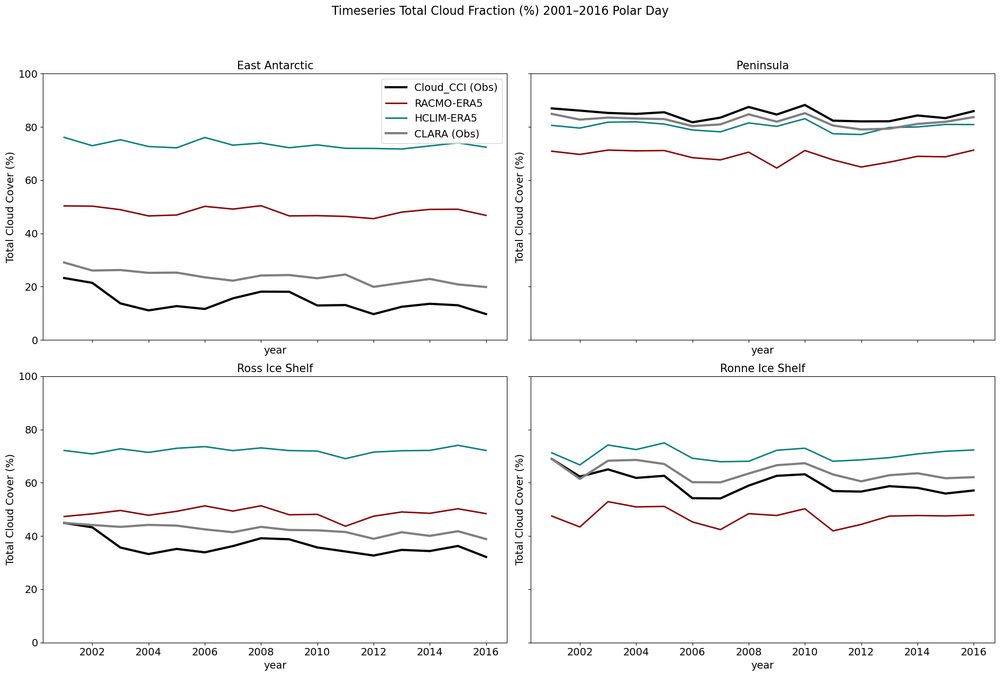

In [465]:
#['rosybrown', 'firebrick', 'peru', 'teal', 'indigo']
plt.rcParams.update({
     'axes.titlesize': 15,        # Title size
     'axes.labelsize': 14,         # Axis label size
     'lines.linewidth': 2,         # Line width
     'lines.markersize': 2,       # Marker size for lines
     'xtick.labelsize': 14,        # X-tick label size
     'ytick.labelsize': 14         # Y-tick label size
})

# ---------- Styling (observations, ERA5-driven models, ensemble) ----------
style = {
     'Cloud_CCI':   {'color': 'k',          'lw': 3.0, 'ls': '-',  'label':'Cloud_CCI (Obs)'},
     'CLARA':       {'color': '#7F7F7F',    'lw': 3.0, 'ls': '-', 'label':'CLARA (Obs)'},
#     'ICON_ERA5':   {'color': 'blue',  'lw': 2.0, 'ls': '-',  'label':'ICON-ERA5'},
     'RACMO_ERA5':  {'color': 'darkred',     'lw': 2.0, 'ls': '-',  'label':'RACMO-ERA5'},
     'HCLIM_ERA5':  {'color': 'teal','lw': 2.0, 'ls': '-',  'label':'HCLIM-ERA5'},
#     'WRF_ERA5':    {'color': 'orange',  'lw': 2.0, 'ls': '-', 'label':'WRF-ERA5'},
#     'ensmean':     {'color': 'magenta',    'lw': 3.5, 'ls': '--', 'label':'Ensemble mean'},
     # GCM-driven (commented out per your request)
     # 'ICON_CNRM':   {'color': 'lightskyblue','lw': 1.5, 'ls': '--','label': 'ICON-CNRM'},
     # 'ICON_NorESM': {'color': 'navy',       'lw': 1.5, 'ls': ':', 'label': 'ICON-NorESM'},
     # 'RACMO_CNRM':  {'color': 'orangered',  'lw': 1.5, 'ls': '--','label': 'RACMO-CNRM'},
     # 'RACMO_NorESM':{'color': 'firebrick',  'lw': 1.5, 'ls': ':', 'label': 'RACMO-NorESM'},
}

def areamean(da):
     return da.mean(dim=('rlat','rlon'), skipna=True)

# ---------- Figure ----------
fig, axs = plt.subplots(2, 2, figsize=(19, 13), sharex=True, sharey=True)
axs = axs.flatten()

# ------------ EastAntarctic (axs[0]) ------------
areamean(EastAntarctic_CloudCCI.cltCCI).plot(ax=axs[0], **style['Cloud_CCI'])
areamean(EastAntarctic_RACMO_ERA5).plot(ax=axs[0], **style['RACMO_ERA5'])
areamean(EastAntarctic_HCLIM_ERA5.clt).plot(ax=axs[0], **style['HCLIM_ERA5'])
areamean(EastAntarctic_CLARA.cfc).plot(ax=axs[0], **style['CLARA'])
axs[0].set_title('East Antarctic')
axs[0].legend(fontsize=14,loc='upper right')

# ------------ Peninsula (axs[1]) ------------
areamean(Peninsula_CloudCCI.cltCCI).plot(ax=axs[1], **style['Cloud_CCI'])
areamean(Peninsula_RACMO_ERA5).plot(ax=axs[1], **style['RACMO_ERA5'])
areamean(Peninsula_HCLIM_ERA5.clt).plot(ax=axs[1], **style['HCLIM_ERA5'])
areamean(Peninsula_CLARA.cfc).plot(ax=axs[1], **style['CLARA'])
axs[1].set_title('Peninsula')

# ------------ Ross (axs[2]) ------------
areamean(Ross_CloudCCI.cltCCI).plot(ax=axs[2], **style['Cloud_CCI'])
areamean(Ross_RACMO_ERA5).plot(ax=axs[2], **style['RACMO_ERA5'])
areamean(Ross_HCLIM_ERA5.clt).plot(ax=axs[2], **style['HCLIM_ERA5'])
areamean(Ross_CLARA.cfc).plot(ax=axs[2], **style['CLARA'])
axs[2].set_title('Ross Ice Shelf')

# ------------ Central Greenland (axs[3]) ------------
areamean(Weddel_CloudCCI.cltCCI).plot(ax=axs[3], **style['Cloud_CCI'])
areamean(Weddel_RACMO_ERA5).plot(ax=axs[3], **style['RACMO_ERA5'])
areamean(Weddel_HCLIM_ERA5.clt).plot(ax=axs[3], **style['HCLIM_ERA5'])
areamean(Weddel_CLARA.cfc).plot(ax=axs[3], **style['CLARA'])
axs[3].set_title('Ronne Ice Shelf')

# ---------- Cosmetics ----------
for ax in axs:
     #ax.grid(True, alpha=0.3)
    ax.set_ylim(0, 100)  # uncomment if you want consistent y-limits
    ax.set_ylabel('Total Cloud Cover (%)')


# single, nice legend across the top
# grab handles/labels from the first axes (they're identical across panels)
#handles, labels = axs[0].get_legend_handles_labels()
#fig.legend(handles, labels, loc='lower center', ncol=5, frameon=False,fontsize=12)

fig.suptitle('Timeseries Total Cloud Fraction (%) 2001–2016 Polar Day',
fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.94])

plt.savefig('ensemble_mean_areas.png',dpi=300,bbox_inches='tight')
plt.show()